In [1]:
import scanpy as sc
import seaborn as sns
import pandas as pd
from scipy.stats import median_abs_deviation
import numpy as np
import matplotlib.pyplot as plt
import scrublet as scr
from tqdm.notebook import tqdm


# Goals

- QC metrics
- Plot cell type annotaions

# Load Adata

In [2]:
ADATA_PATH = '/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/labelled_adata.h5ad'
adata = sc.read_h5ad(ADATA_PATH)

print(adata)

AnnData object with n_obs × n_vars = 34704 × 38606
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient'
    var: 'feature_types', 'genome', 'gene_symbol'
    obsm: 'spatial'
    layers: 'counts'


# Calculate QC Metrics

In [3]:
# Calculate qc
adata.var["mt"] = adata.var.gene_symbol.str.startswith("MT-") # mitochondrial genes, ATTNETION: the names are in "gene_symbol"
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], inplace=True)

In [4]:
# scrub = scr.Scrublet(adata.X, expected_doublet_rate=0.06)
#     # raw count matrix
#     # for single sample
# doublet_scores, predicted_doublets = scrub.scrub_doublets(
#     min_counts=2,
#     min_cells=3,
#     min_gene_variability_pctl=85,
#     n_prin_comps=30
# )

# adata.obs['doublet_score'] = doublet_scores
# adata.obs['predicted_doublet'] = predicted_doublets

# print(f"\nScrublet results:")
# print(f"  Predicted doublets: {predicted_doublets.sum()} ({100*predicted_doublets.sum()/len(adata):.1f}%)")
# print(f"  Mean doublet score: {doublet_scores.mean():.3f}")

# scrub.plot_histogram()

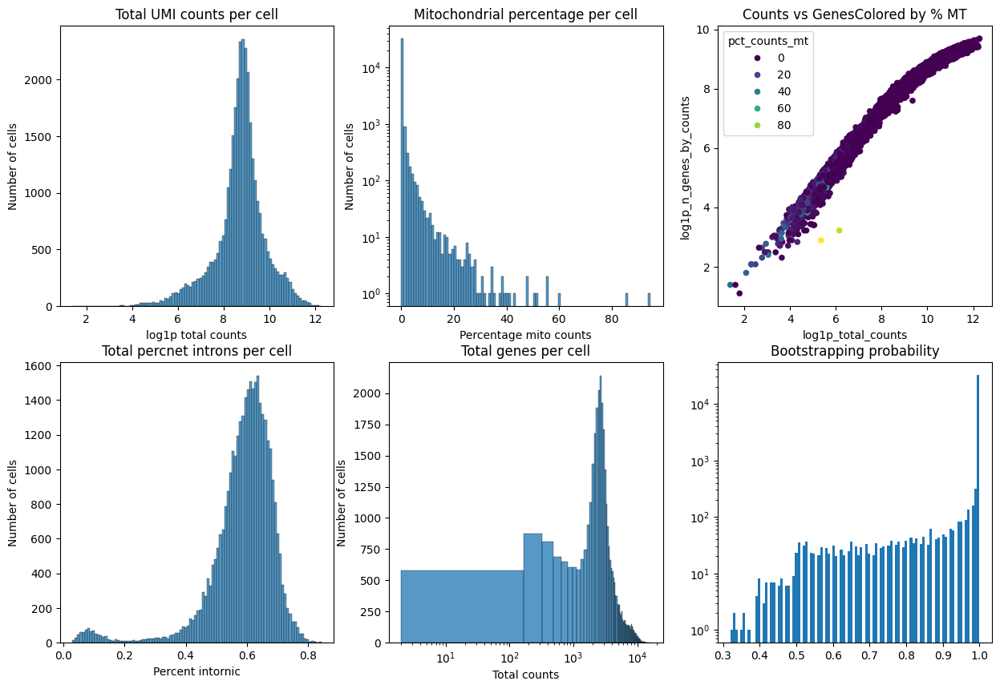

In [5]:
fig, axes = plt.subplots(2,3, figsize=(15, 10))

axes = axes.flatten()

# --- 1. Total UMI counts ---
    # GOOD
        # Single, smooth peak (unimodal distribution)
        # Peak centered around 8-10 on log scale (roughly 3,000-20,000 UMIs)
        # Narrow spread
    # BAD
        # Two peaks (bimodal): Suggests two populations - one could be empty droplets or debris
        # Very wide spread: Indicates high variability in sequencing depth between cells
        # Long left tail: Presence of empty droplets or broken cells
        # peask less than 7
sns.histplot(adata.obs["log1p_total_counts"], bins=100, kde=False, ax=axes[0])
axes[0].set_title("Total UMI counts per cell")
axes[0].set_ylabel("Number of cells")
axes[0].set_xlabel("log1p total counts")

# --- 2. Mitochondrial counts ---
    # GOOD
        # Most cells clustered at lower values
        # Smooth, single-peaked shape
    # BAD
        # Heavy upper tail: Many dying/stressed cells
        # Bimodal (two bumps): Two populations with different health states
sns.histplot(adata.obs["pct_counts_mt"], bins=100, kde=False, ax=axes[1])
axes[1].set_title("Mitochondrial percentage per cell")
axes[1].set_ylabel("Number of cells")
axes[1].set_xlabel("Percentage mito counts")
axes[1].set_yscale("log")

# --- 3. Scatter: counts vs genes, colored by mito ---
    # GOOD
        # Strong positive correlation: Diagonal line from bottom-left to top-right: More total counts = more genes detected
    # BAD
        #  Cells in bottom-left corner (low counts, low genes) --< Empty droplets or debris
sns.scatterplot(
    x=adata.obs["log1p_total_counts"],
    y=adata.obs["log1p_n_genes_by_counts"],
    hue=adata.obs["pct_counts_mt"],
    ax=axes[2],
    s=30,        # point size
    linewidth=0, 
    palette="viridis"
)
axes[2].set_title("Counts vs GenesColored by % MT")

# --- 4. % introns ---
    # GOOD

    # BAD
        # having 2 peaks

sns.histplot(adata.obs["pct_intronic"], bins=100, kde=False, ax=axes[3])
axes[3].set_title("Total percnet introns per cell")
axes[3].set_ylabel("Number of cells")
axes[3].set_xlabel("Percent intornic")

# --- 5. n genes ---
    # GOOD

    # BAD

sns.histplot(adata.obs["n_genes_by_counts"], bins=100, kde=False, ax=axes[4])
axes[4].set_title("Total genes per cell")
axes[4].set_ylabel("Number of cells")
axes[4].set_xlabel("Total counts")
axes[4].set_xscale("log")

# --- 6. mapmycell probs ---
    # GOOD

    # BAD
axes[5].hist(
    adata.obs['Class_bootstrapping_probability'].dropna(),
    bins=100, log=True
)
axes[5].set_title("Bootstrapping probability")

#plt.tight_layout()
plt.show()


# Minimal Filter cells

In [6]:
# # Filter cells based qc: count per cell, genes per cell, % mt --< using MAD approach 
#     # MAD, sort of std = median of the absloution differcnes form the median
#     # MAD = "How far from typical is this cell?"
#     #Lower threshold = Median - (nmads × MAD)
#     #Upper threshold = Median + (nmads × MAD)
#     # outlier if ANY of these are true --< OR

# def is_outlier(adata, metric: str, nmads: int, direction: str = "both"):
    
#     M = adata.obs[metric]
#     median = np.median(M)
#     mad = median_abs_deviation(M)
    
#     lower_bound = median - nmads * mad
#     upper_bound = median + nmads * mad
    
#     if direction == "both":
#         outlier = (M < lower_bound) | (M > upper_bound)
#     elif direction == "upper":
#         outlier = M > upper_bound
#     elif direction == "lower":
#         outlier = M < lower_bound
#     else:
#         raise ValueError(f"direction must be 'both', 'upper', or 'lower', got '{direction}'")
    
#     return outlier



#'MAD_lower_total_UMI_per_cell': ~is_outlier(adata, "log1p_total_counts", 5, "lower"),


In [7]:
print(f"Starting: {adata.n_obs:,} cells\n")

# Calculate all filters (keep = pass filter)
filters = { # lists of boolen (True == to keep)
    
    'min_UMI': adata.obs["total_counts"] >= 500,
    'min_genes': adata.obs["n_genes_by_counts"] >= 500,
    'mt_threshold': adata.obs["pct_counts_mt"] <= 8,
    'is_cell_dropsift': adata.obs["is_cell"] == True,
    'percent_intronic_threshold': adata.obs["pct_intronic"] >= 0.2,
    'mapmycells_probs_class': (adata.obs['Class_bootstrapping_probability'] >= 0.5), # & (adata.obs['Class_correlation_coefficient'] >= 0.5),
    'spatial_present': ~adata.obs.x.isna(),
}

# Print individual filter stats
n_start = len(adata)
for name, filt in filters.items():
    removed = (~filt).sum()
    print(f"{name:30s}: {removed:6,} removed ({100*removed/len(adata):5.1f}%)")

# Replace adata
cells_to_keep = pd.DataFrame(filters).all(axis=1)  # AND
adata = adata[cells_to_keep].copy()

print(f"Final: {adata.n_obs:,} / {n_start:,} cells retained ({100*adata.n_obs/n_start:.1f}%)")

Starting: 34,704 cells

min_UMI                       :  1,172 removed (  3.4%)
min_genes                     :  2,315 removed (  6.7%)
mt_threshold                  :    248 removed (  0.7%)
is_cell_dropsift              :  1,323 removed (  3.8%)
percent_intronic_threshold    :    813 removed (  2.3%)
mapmycells_probs_class        :     79 removed (  0.2%)
spatial_present               :    739 removed (  2.1%)
Final: 31,241 / 34,704 cells retained (90.0%)


In [8]:
# Filter genes
print(f"   Genes before filtering: {adata.n_vars}")
sc.pp.filter_genes(adata, min_cells=3)
print(f"   Genes after filtering: {adata.n_vars}")

   Genes before filtering: 38606
   Genes after filtering: 33848


# Processing Pipeline

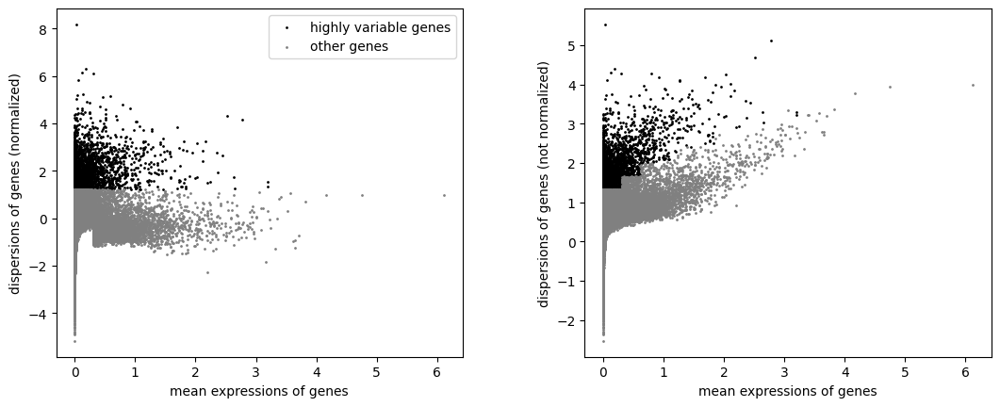

/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


In [9]:
# Normalize & Transform --> X amtrix changes
sc.pp.normalize_total(adata, target_sum=1e4, inplace=True)
sc.pp.log1p(adata)
adata.layers["log1p_norm"] = adata.X.copy()

# HVG
sc.pp.highly_variable_genes(adata, n_top_genes=3000)
sc.pl.highly_variable_genes(adata, show=True)
    # BAD: nif there is not clear seapration

# scale
    # ATTENTION: now X stores nroalised counts --> not used for all stat test alter
sc.pp.scale(adata, max_value=10) #z-score normalization


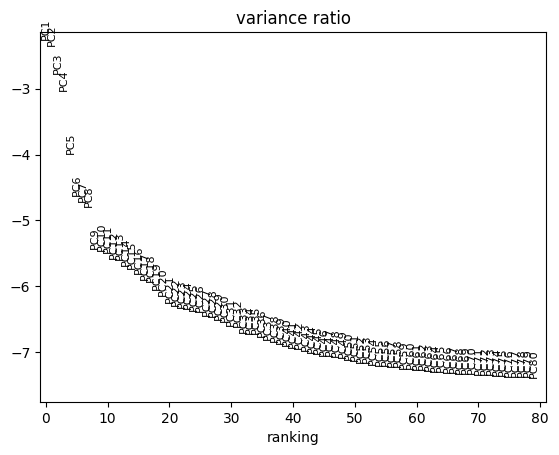

,x,y,pct_intronic,is_cell,Neighborhood_label,Neighborhood_name,Neighborhood_bootstrapping_probability,Neighborhood_aggregate_probability,Neighborhood_correlation_coefficient,Class_label,...,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,leiden_1,leiden_2,leiden_3,leiden_4
AAACCAAAGATAACAG-1,33013.428400,444.562211,0.585746,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.6303,CS20250428_CLASS_0000,...,21.110963,28.975831,44.358392,21,3.091042,0.280411,0,0,0,0
AAACCAAAGCATGGAG-1,21225.159553,4193.340108,0.596834,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7041,CS20250428_CLASS_0008,...,26.516544,36.810662,55.124081,3,1.386294,0.068934,3,3,2,3
AAACCAAAGGCGGAGT-1,16429.015488,3852.143369,0.716821,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7610,CS20250428_CLASS_0010,...,31.480911,42.533867,60.899015,0,0.000000,0.000000,4,5,4,4
AAACCAAAGGTCTATG-1,43242.438818,-1822.457007,0.609493,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.6028,CS20250428_CLASS_0000,...,44.152047,58.830409,80.877193,0,0.000000,0.000000,0,0,7,1
AAACCAAAGGTTGTAT-1,14118.369028,-4852.270550,0.588186,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7130,CS20250428_CLASS_0010,...,35.483871,46.738351,65.017921,4,1.609438,0.095579,4,6,8,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTTGTGGGTCCGTCCA-1,57226.380126,-635.403689,0.597685,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7741,CS20250428_CLASS_0010,...,25.170252,33.153530,47.070326,22,3.135494,0.148338,3,3,3,29
GTTGTGGGTCGAAGCC-1,46045.094685,3106.066837,0.630523,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7561,CS20250428_CLASS_0010,...,29.939091,40.402936,58.472591,7,2.079442,0.109324,4,6,8,7
GTTGTGGGTGCACGTA-1,9851.267283,7168.714885,0.541554,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7351,CS20250428_CLASS_0010,...,28.037245,37.363287,53.813184,11,2.484907,0.162578,4,6,6,13
GTTGTGGGTGGCGTGT-1,17765.143818,-4292.867209,0.630550,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.5699,CS20250428_CLASS_0000,...,43.639740,60.259981,88.115135,0,0.000000,0.000000,0,0,7,1


In [10]:
# PCA
sc.tl.pca(adata, svd_solver='arpack', n_comps=80) # ATTENTION: # Uses HVGs only (if calculted, even if the adat has all geens)
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=80, show=True)
N_PCS_ELBOW = 30

# neighbours (for umap and leiden)
sc.pp.neighbors(adata, use_rep='X_pca', n_pcs=N_PCS_ELBOW) # from X_pca

# umap
sc.tl.umap(adata) # uese neighbors

# clustering
sc.tl.leiden(adata, resolution=0.1, key_added="leiden_1", flavor="igraph", n_iterations=2) # use neighbors
sc.tl.leiden(adata, resolution=0.5, key_added="leiden_2", flavor="igraph", n_iterations=2)
sc.tl.leiden(adata, resolution=1.0, key_added="leiden_3", flavor="igraph", n_iterations=2)
sc.tl.leiden(adata, resolution=2.0, key_added="leiden_4", flavor="igraph", n_iterations=2)

adata.obs


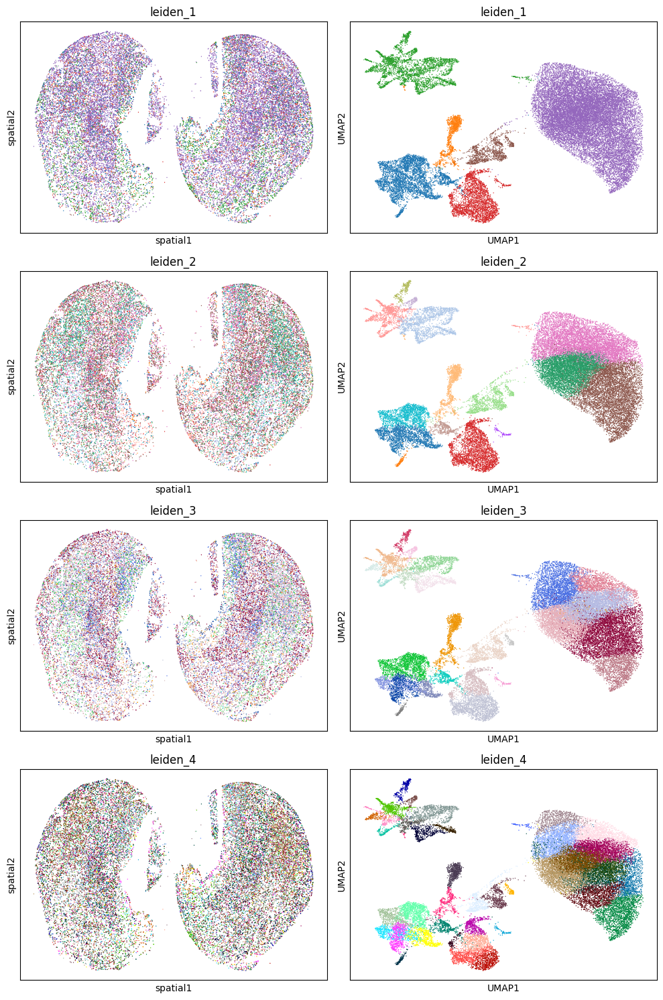

In [11]:
fig, axes = plt.subplots(4, 2, figsize=(10, 15))

for i, res in enumerate(["leiden_1", "leiden_2", "leiden_3", "leiden_4"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

# Save Minimal filtered Adata

In [12]:
adata.write('/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/minimal_filtered_adata.h5ad')
del(adata)

In [13]:
adata = sc.read_h5ad('/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/minimal_filtered_adata.h5ad')

# Filtering by cluster

## Bad quality QC metrics clusters

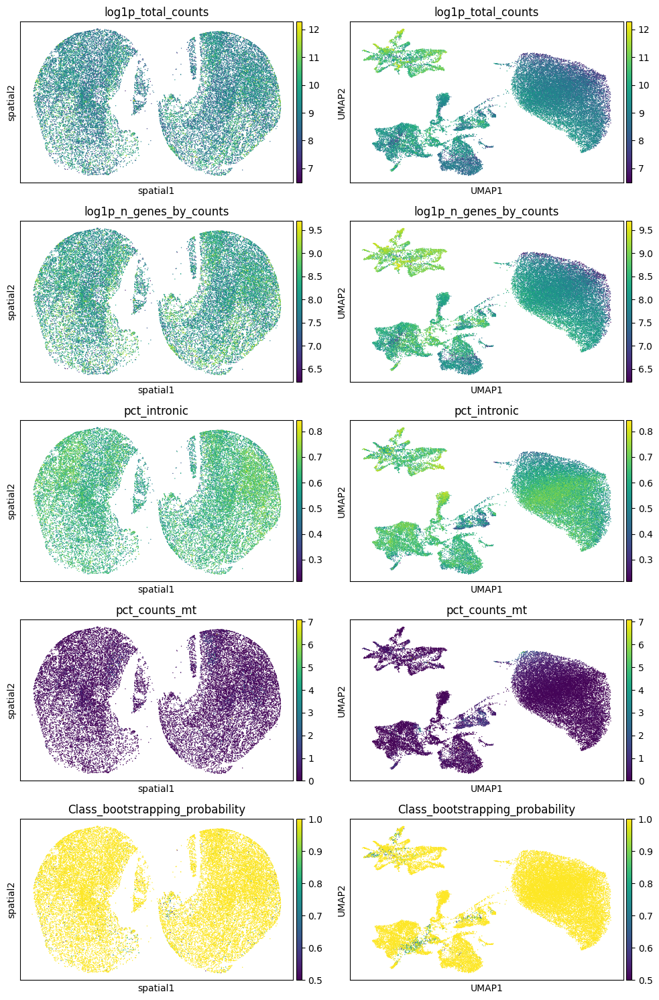

In [14]:
fig, axes = plt.subplots(5, 2, figsize=(10, 15))

for i, res in enumerate(["log1p_total_counts", "log1p_n_genes_by_counts", "pct_intronic", "pct_counts_mt", "Class_bootstrapping_probability"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

['9', '14', '16', '17', '19', '20', '23', '26', '30', '31', '32', '37', '39']


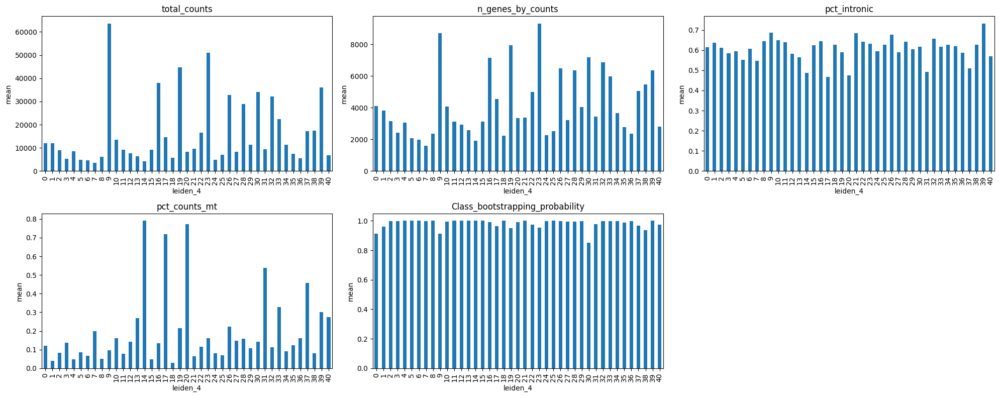

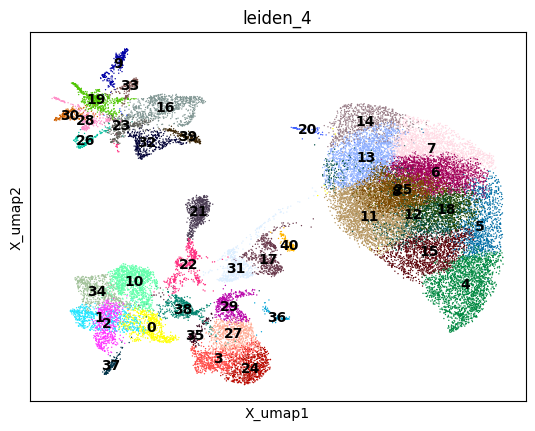

In [15]:
metrics = [
    "total_counts",
    "n_genes_by_counts",
    "pct_intronic",
    "pct_counts_mt",
    "Class_bootstrapping_probability",
]

# compute mean of each metric for each cluster
df_means = (
    adata.obs
    .groupby("leiden_4", observed=False)[metrics]
    .mean()
    .reset_index()
)


df_means = df_means.set_index("leiden_4")
# display(df_means)

# flag clusters where ANY metric is > 2 SD above mean
# thresholds
putative_bad_clusters_by_qc = df_means[(
    (df_means["total_counts"] > 30000) |
    (df_means["n_genes_by_counts"] > 7000) |
    (df_means["pct_intronic"] < 0.4) | 
    (df_means["pct_intronic"] > 0.8) |
    (df_means["pct_counts_mt"] > 0.4) |
    (df_means["Class_bootstrapping_probability"] < 0.7)
)].index.tolist()
print(putative_bad_clusters_by_qc)


# Plot
fig, axes = plt.subplots(2, 3, figsize=(20, 8))
axes = axes.flatten()

for ax, col in zip(axes, metrics):
    df_means[col].plot(kind="bar", ax=ax)
    ax.set_title(col)
    ax.set_ylabel("mean")
    ax.tick_params(axis="x")#, rotation=45)

# hide any unused axes
for ax in axes[len(metrics):]:
    ax.set_visible(False)

plt.tight_layout()
plt.show()


sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data")


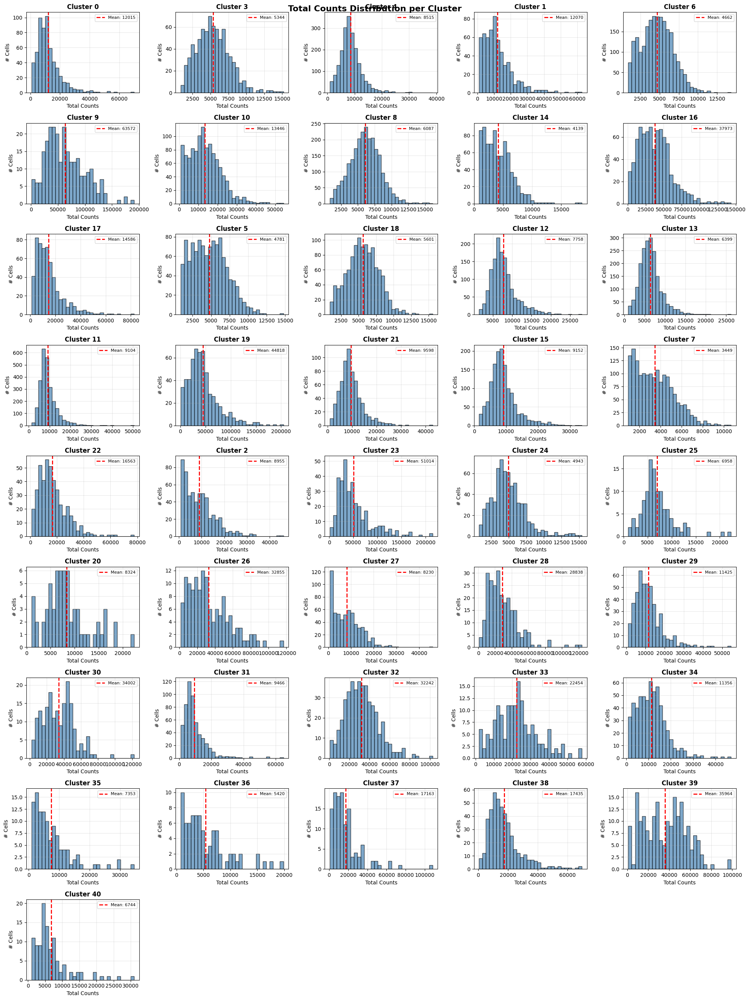

In [16]:
# Get unique clusters
clusters = adata.obs['leiden_4'].unique()

n_clusters = len(clusters)
ncols = 5
nrows = int(np.ceil(n_clusters / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(20, 3*nrows))
axes = axes.flatten()

for idx, cluster in enumerate(clusters):
    ax = axes[idx]
    
    # Get data for this cluster
    cluster_data = adata.obs[adata.obs['leiden_4'] == cluster]['total_counts']
    
    # Plot histogram
    ax.hist(cluster_data, bins=30, color='steelblue', alpha=0.7, edgecolor='black')
    ax.set_title(f'Cluster {cluster}', fontweight='bold')
    ax.set_xlabel('Total Counts')
    ax.set_ylabel('# Cells')
    
    # Add mean line
    mean_val = cluster_data.mean()
    ax.axvline(mean_val, color='red', linestyle='--', linewidth=2, 
               label=f'Mean: {mean_val:.0f}')
    
    # Same x-axis for all
    #ax.set_xlim(global_min, global_max)
    ax.legend(fontsize=8)
    ax.grid(alpha=0.3)

# Hide unused subplots
for idx in range(n_clusters, len(axes)):
    axes[idx].axis('off')

plt.suptitle('Total Counts Distribution per Cluster', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

## Doublets clusters

excluding cell clusters that co-express marker genes of distinct cell types (not UMI based approach).

Problem: Homotypic doublets (formed by transcriptionally similar cells) cannot be detected this way

Check if the doublet cluster is positioned between its "parent" clusters in UMAP space


In [17]:
markers = {
    # Non-neuronal cells
    'Astrocyte': ['GFAP', 'AQP4', 'GINS3'],
    
    'Ependymal': ['ZBBX'],
    
    'Endothelial': ['DCN', 'FLT1'],
    
    'Lymphocyte': ['SKAP1', 'THEMIS'],
    
    'Microglia': ['CX3CR1', 'P2RY12', 'C1QA', 'C1QB', 'C1QC'],
    
    'Macrophage': ['CD163', 'CD200R1'],
    
    'Oligodendrocyte': ['MOBP', 'MBP', 'TF', 'PLP1', 'SHROOM4'],
    
    'OPC': ['VCAN', 'PDGFRA'],
    
    # Neurons - using ONLY subtype-specific markers (no RBFOX3/SYT1 overlap)
    'Neuron_inhibitory': ['GAD1', 'GAD2', 'SLC32A1'],
    
    'Neuron_excitatory': ['SLC17A6', 'SLC17A7', 'SLC17A8'],
    
    'Neuron_dopaminergic': ['SLC6A3', 'TH'],
    
    'Neuron_cholinergic': ['CHAT'],
    
    'Neuron_serotonergic': ['SLC6A4'],
}

mapping_genes_name_dict = adata.var[["gene_symbol"]].to_dict()["gene_symbol"].copy()
symbol_to_varid = {v.upper(): k for k, v in mapping_genes_name_dict.items() if isinstance(v, str)}
translated_markers = {
    celltype: [symbol_to_varid.get(gene.upper(), None) for gene in genes]
    for celltype, genes in markers.items()
}

display(translated_markers)


{'Astrocyte': ['ENSG00000131095', 'ENSG00000171885', 'ENSG00000181938'],
 'Ependymal': ['ENSG00000169064'],
 'Endothelial': ['ENSG00000011465', 'ENSG00000102755'],
 'Lymphocyte': ['ENSG00000141293', 'ENSG00000172673'],
 'Microglia': ['ENSG00000168329',
  'ENSG00000169313',
  'ENSG00000173372',
  'ENSG00000173369',
  'ENSG00000159189'],
 'Macrophage': ['ENSG00000177575', 'ENSG00000163606'],
 'Oligodendrocyte': ['ENSG00000168314',
  'ENSG00000197971',
  'ENSG00000091513',
  'ENSG00000123560',
  'ENSG00000158352'],
 'OPC': ['ENSG00000038427', 'ENSG00000134853'],
 'Neuron_inhibitory': ['ENSG00000128683',
  'ENSG00000136750',
  'ENSG00000101438'],
 'Neuron_excitatory': ['ENSG00000091664',
  'ENSG00000104888',
  'ENSG00000179520'],
 'Neuron_dopaminergic': ['ENSG00000142319', 'ENSG00000180176'],
 'Neuron_cholinergic': ['ENSG00000070748'],
 'Neuron_serotonergic': ['ENSG00000108576']}

### Based on gene Markers

Finde gene makers (DEGs) for each cluster and see if they are ibtersection with makrher genes of a specific cell type.

If they overlap wiht more than 2 cell types they coudl be doublets.

In [18]:
# Find marker genes for each cluster (equivalent to FindAllMarkers)
    # need log normlsied data --< NPY scaled
    # DEG: cluster Vs rest
sc.tl.rank_genes_groups(
    adata, 
    groupby='leiden_4', 
    method='wilcoxon', 
    reference="rest", 
    corr_method="benjamini-hochberg",
    use_raw=False, 
    layer="log1p_norm", 
    pts = True, # ATTENTION; % cells expressing gene IN and OUT cluster 
)

/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:463: Perform

  0%|          | 0/41 [00:00<?, ?it/s]

{'0': ['Astrocyte', 'OPC'],
 '1': ['Astrocyte', 'OPC'],
 '2': ['Astrocyte', 'OPC'],
 '10': ['Astrocyte', 'OPC'],
 '21': ['OPC', 'Neuron_inhibitory'],
 '23': ['Astrocyte', 'Neuron_inhibitory'],
 '35': ['Microglia', 'Macrophage'],
 '37': ['Astrocyte', 'Ependymal'],
 '38': ['Astrocyte', 'Microglia', 'OPC'],
 '40': ['Endothelial', 'OPC']}

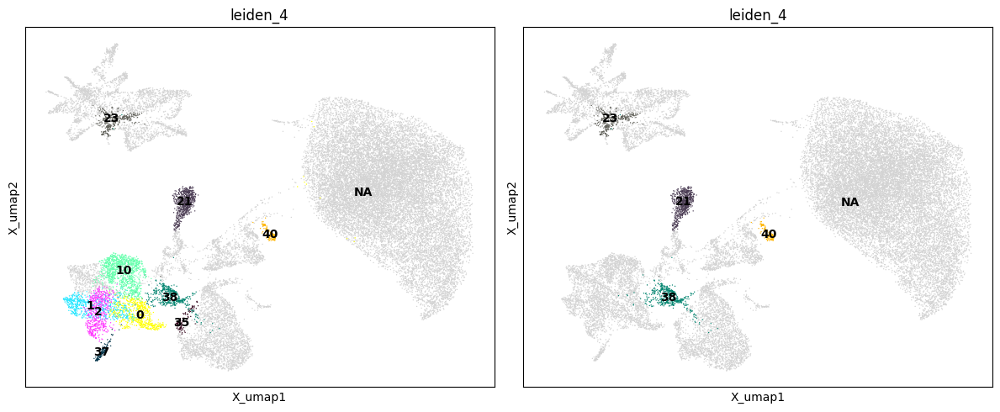

In [19]:
# Get top genes as DataFrame
top_n = 300
doublet_clusters_markers = {}

for cluster in tqdm(adata.obs['leiden_4'].cat.categories):

    # Get top genes for this cluster
    df = sc.get.rank_genes_groups_df(adata, group=cluster) # sorted by score

    df = df[
        (df.pvals_adj < 0.05) &
        (df.logfoldchanges > 1) &
        (df.scores > 0) &
        (df['pct_nz_group'] > 0.25) &  # only test genes that are detected in a minimum fraction  IN cluster
        (df['pct_nz_reference'] < 0.25) & # only test genes NOT expressed outside
        ((df['pct_nz_group'] - df['pct_nz_reference']) > 0.10) # Gene must be >10% more frequent in cluster than outside  
    ] 


    #display(df)
    top_genes = set(df.head(top_n)['names'].tolist())
    #print(top_genes)

    # check if these top genes overlpa wiht one of the gene list of a specific cell type
    cell_types_found = {}
    for cell_type, cell_type_markers in translated_markers.items(): # ATTENTION: gene name
        overlap = top_genes & set(cell_type_markers)
        if len(overlap) != 0:
            cell_types_found[cell_type] = list(overlap)

    if len(cell_types_found.keys()) >= 2:
        doublet_clusters_markers[cluster] = list(cell_types_found.keys())


display(doublet_clusters_markers)


fig, axes = plt.subplots(1, 2, figsize=(12, 5))
for ax, g in zip(axes, [list(doublet_clusters_markers.keys()), ["21","23", "38","40"]]):
    sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
                    groups=g, ax=ax, show=False, return_fig=False)
plt.tight_layout(); plt.show()




### Based on Module score and Entropy

FOr each cell tyope marker genes lists, calculate the relative module socre (for each cell).

Calculate mean module score for each cluster for each module.

Claulte Entropy of these menas per cluster.

CLusters wiht high entropy (mix of modules) are doublets.

  0%|          | 0/13 [00:00<?, ?it/s]

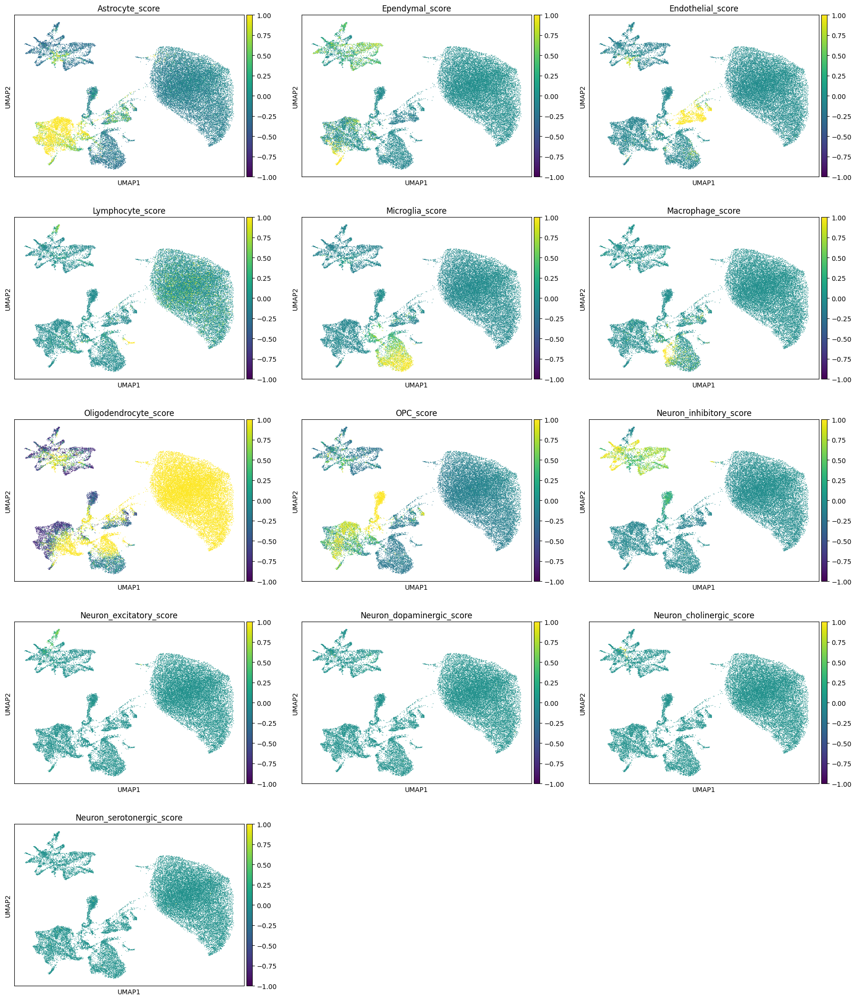

In [20]:
# DOUBLETS USING MODULE SCORE

for cell_type, genes in tqdm(translated_markers.items()):
    # Only use genes that exist in your data
    #genes_available = [g for g in genes if g in adata.var.gene_symbol.to_list()]
    
    if len(genes) > 0:
        #print(f"  {cell_type}: {len(genes)} markers")
        sc.tl.score_genes(adata, genes, score_name=f'{cell_type}_score', use_raw=False, layer="log1p_norm") # normalised scores (not scaled)
    else:
        print(f"  ⚠ {cell_type}: No markers found!")

# plot umaps
score_cols = [f'{ct}_score' for ct in markers.keys() if f'{ct}_score' in adata.obs]
sc.pl.umap(adata, color=score_cols, cmap='viridis', ncols=3, vmin=-1, vmax=1)


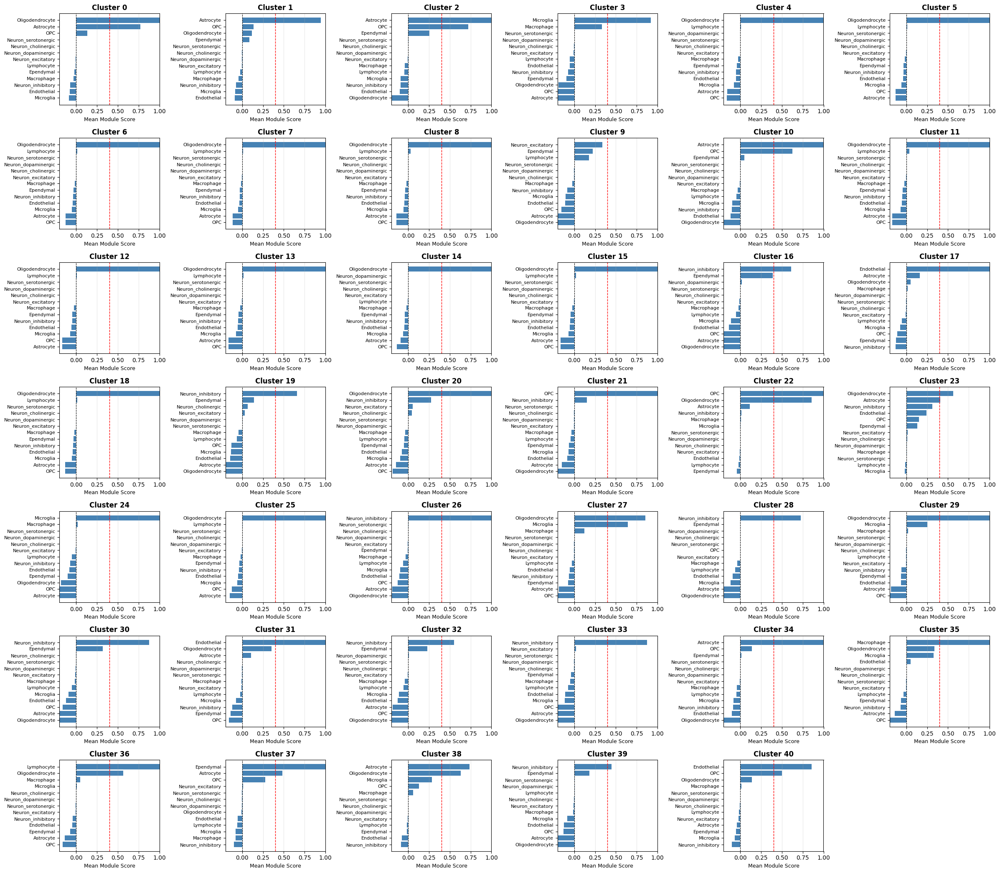

In [21]:
# plot moduels per cluster
# Get mean scores per cluster
cluster_scores = adata.obs.groupby("leiden_4", observed=False)[score_cols].mean()

# Clean column names
cluster_scores.columns = [c.replace('_score', '') for c in cluster_scores.columns]

# Simple barplot - one per cluster
n_clusters = len(cluster_scores)
ncols = 6
nrows = int(np.ceil(n_clusters / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 3*nrows))
axes = axes.flatten() if n_clusters > 1 else [axes]

for idx, (cluster, row) in enumerate(cluster_scores.iterrows()):
    ax = axes[idx]
    
    # Sort values for easier reading
    sorted_data = row.sort_values(ascending=True)
    
    # Plot
    ax.barh(range(len(sorted_data)), sorted_data.values, color='steelblue')
    ax.set_yticks(range(len(sorted_data)))
    ax.set_yticklabels(sorted_data.index, fontsize=8)
    ax.set_xlabel('Mean Module Score', fontsize=9)
    ax.set_title(f'Cluster {cluster}', fontweight='bold')
    ax.axvline(0, color='black', linestyle='--', linewidth=0.8)
    ax.grid(axis='x', alpha=0.3)
    ax.set_xlim((-0.2, 1))
    ax.axvline(0.4, linestyle='--', linewidth=1, color="red")

# Hide empty subplots
for idx in range(n_clusters, len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()


# cluster_scores_filtered = cluster_scores.copy()
# cluster_scores_filtered[cluster_scores_filtered<0.5] = "0"
# mask = (cluster_scores_filtered != "0").sum(axis=1) > 1
# cluster_scores_filtered = cluster_scores_filtered[mask]
# display(cluster_scores_filtered.round(2))

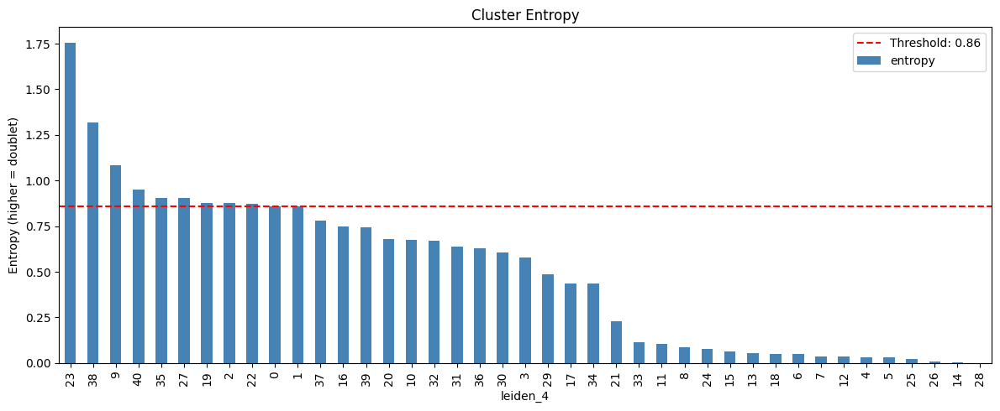

Entropy-based doublet clusters:


{'0': ['Oligodendrocyte', 'Astrocyte', 'OPC'],
 '2': ['Astrocyte', 'OPC', 'Ependymal'],
 '9': ['Neuron_excitatory', 'Ependymal', 'Lymphocyte'],
 '19': ['Neuron_inhibitory', 'Ependymal', 'Neuron_cholinergic'],
 '22': ['OPC', 'Oligodendrocyte', 'Astrocyte'],
 '23': ['Oligodendrocyte', 'Astrocyte', 'Neuron_inhibitory'],
 '27': ['Oligodendrocyte', 'Microglia', 'Macrophage'],
 '35': ['Macrophage', 'Oligodendrocyte', 'Microglia'],
 '38': ['Astrocyte', 'Oligodendrocyte', 'Microglia'],
 '40': ['Endothelial', 'OPC', 'Oligodendrocyte']}

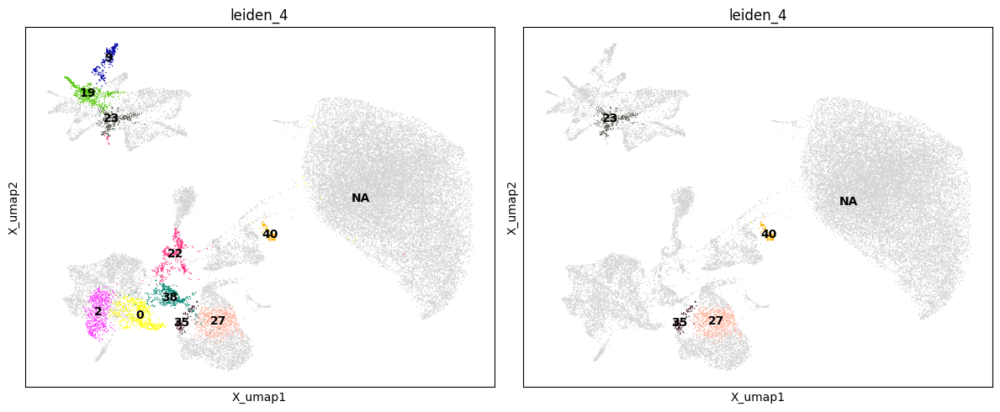

In [22]:
from scipy.stats import entropy

# Calculate entropy for each cluster (higher = more mixed)
cluster_scores_entropy = cluster_scores.copy()
cluster_scores_entropy['entropy'] = cluster_scores.apply(
    lambda x: entropy(x[x > 0] / x[x > 0].sum()) if (x > 0).sum() > 1 else 0,  # clauclte onyl for vlaues bogger than 0
    axis=1
)

# Flag top 25% as potential doublets
threshold = cluster_scores_entropy['entropy'].quantile(0.75)
high_entropy_clusters = cluster_scores_entropy[cluster_scores_entropy['entropy'] > threshold]

# Plot
cluster_scores_entropy['entropy'].sort_values(ascending=False).plot(
    kind='bar', figsize=(12, 5), color='steelblue', title='Cluster Entropy'
)
plt.axhline(threshold, color='red', linestyle='--', label=f'Threshold: {threshold:.2f}')
plt.ylabel('Entropy (higher = doublet)')
plt.legend()
plt.tight_layout()
plt.show()

# Create doublet dictionary: cluster -> cell types with high scores
doublet_clusters_entropy = {}
for cluster in high_entropy_clusters.index:
    scores = cluster_scores_entropy.loc[cluster].drop('entropy')
    # Get cell types with scores > 0.3
    threshold = scores.quantile(0.75) 
    active_types = scores[scores > threshold].sort_values(ascending=False)
    if len(active_types) >= 2:
        doublet_clusters_entropy[cluster] = active_types.index.tolist()

# Display results
print("Entropy-based doublet clusters:")
display(doublet_clusters_entropy)

# Plot
fig, axes = plt.subplots(1, 2, figsize=(12, 5))
for ax, clusters in zip(axes, [list(doublet_clusters_entropy.keys()), ["23", "27", "35","40"]]):
    sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
                    groups=clusters, ax=ax, show=False)
plt.tight_layout()
plt.show()

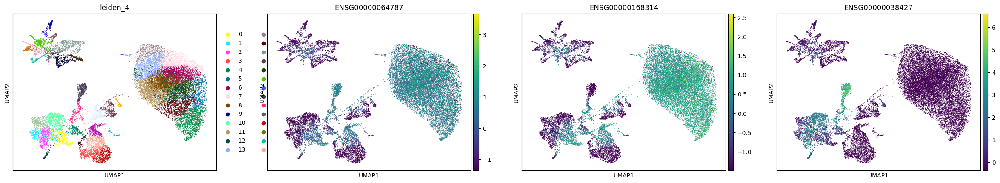

In [23]:
# Check if they're differentiating OPCs (real) or doublets (artifact)
#(Oligo + OPC)
# REAL BIOLOGY (good) ✓
# OPC differentiating into Oligodendrocyte
# → Transition state, should KEEP!
#  BCAS1 expression (differentiation marker) --> BCAS1 high → Real differentiating cells → KEEP ✓
genes = ['BCAS1', 'MOBP', 'VCAN']
genes_var = [symbol_to_varid[g] for g in genes]
sc.pl.umap(adata, color=['leiden_4']+genes_var)

## Check overmapping doublets clusters

{'0': [['Oligodendrocyte', 'Astrocyte', 'OPC'], ['Astrocyte', 'OPC']],
 '2': [['Astrocyte', 'OPC', 'Ependymal'], ['Astrocyte', 'OPC']],
 '23': [['Oligodendrocyte', 'Astrocyte', 'Neuron_inhibitory'],
  ['Astrocyte', 'Neuron_inhibitory']],
 '35': [['Macrophage', 'Oligodendrocyte', 'Microglia'],
  ['Microglia', 'Macrophage']],
 '38': [['Astrocyte', 'Oligodendrocyte', 'Microglia'],
  ['Astrocyte', 'Microglia', 'OPC']],
 '40': [['Endothelial', 'OPC', 'Oligodendrocyte'], ['Endothelial', 'OPC']]}

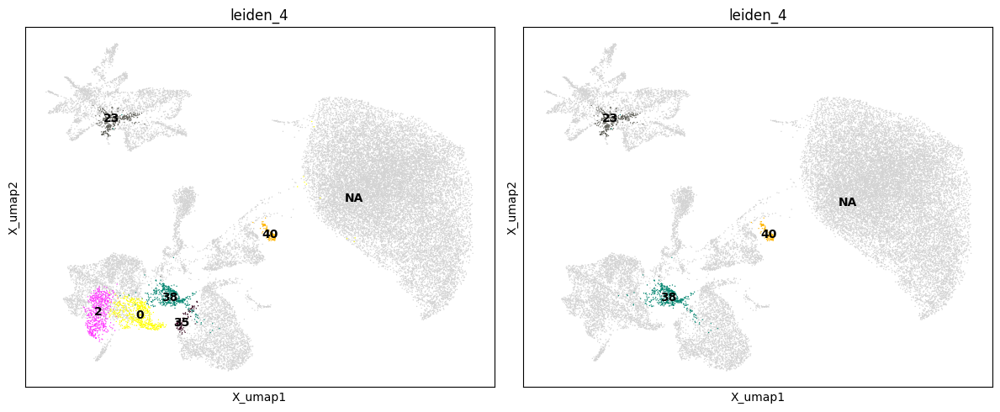

In [24]:
common_keys = sorted(doublet_clusters_entropy.keys() & doublet_clusters_markers.keys())

final_dt = {
    k: [doublet_clusters_entropy[k], doublet_clusters_markers[k]]
    for k in common_keys
}

display(final_dt)

fig, axes = plt.subplots(1, 2, figsize=(12, 5))
for ax, clusters in zip(axes, [list(final_dt.keys()), ["23", "38","40"]]):
    sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data",
                    groups=clusters, ax=ax, show=False)
plt.tight_layout()
plt.show()

## Filter

In [25]:
DOUBLET_CLUSTERS = ["23", "38","40"]
print(adata)
adata = adata[~adata.obs["leiden_4"].isin(DOUBLET_CLUSTERS)]
print(adata)

adata.write('/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/doublets_filtered_adata.h5ad')

AnnData object with n_obs × n_vars = 31241 × 33848
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_cou

In [26]:
stop

NameError: name 'stop' is not defined

# Reprocess Clean Data

In [27]:
# ATTENTION: bring bacj count
adata.X = adata.layers["counts"]

# Normalize & Transform --> X amtrix changes
sc.pp.normalize_total(adata, target_sum=1e4, inplace=True)
sc.pp.log1p(adata)
adata.layers["log1p_norm"] = adata.X.copy()

# HVG
sc.pp.highly_variable_genes(adata, n_top_genes=3000)
sc.pl.highly_variable_genes(adata, show=True)
    # BAD: nif there is not clear seapration

# scale
    # ATTENTION: now X stores nroalised counts --> not used for all stat test alter
sc.pp.scale(adata, max_value=10) #z-score normalization

# PCA
sc.tl.pca(adata, svd_solver='arpack', n_comps=80) # ATTENTION: # Uses HVGs only (if calculted, even if the adat has all geens)
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=80, show=True)
N_PCS_ELBOW = 30

# neighbours (for umap and leiden)
sc.pp.neighbors(adata, use_rep='X_pca', n_pcs=N_PCS_ELBOW) # from X_pca

# umap
sc.tl.umap(adata) # uese neighbors

# clustering
sc.tl.leiden(adata, resolution=0.1, key_added="leiden_1", flavor="igraph", n_iterations=2) # use neighbors
sc.tl.leiden(adata, resolution=0.5, key_added="leiden_2", flavor="igraph", n_iterations=2)
sc.tl.leiden(adata, resolution=1.0, key_added="leiden_3", flavor="igraph", n_iterations=2)
sc.tl.leiden(adata, resolution=2.0, key_added="leiden_4", flavor="igraph", n_iterations=2)

adata.write('/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/reprocessed_filtered_adata.h5ad')
del(adata)


/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/anndata/_core/anndata.py:629: FutureWarning: You are attempting to set `X` to a matrix on a view which has non-unique indices. The resulting `adata.X` will likely not equal the value to which you set it. To avoid this potential issue, please make a copy of the data first. In the future, this operation will throw an error.
  warnings.warn(msg, FutureWarning, stacklevel=1)
/tmp/ipykernel_274867/330170493.py:2: UserWarning: Trying to set a dense array with a sparse array on a view.Densifying the sparse array.This may incur excessive memory usage
  adata.X = adata.layers["counts"]
/tmp/ipykernel_274867/330170493.py:2: ImplicitModificationWarning: Modifying `X` on a view results in data being overridden
  adata.X = adata.layers["counts"]
/home/gdallagl/myworkdir/XDP/.venv/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:269: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


: 

In [ ]:
adata = sc.read_h5ad('/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/reprocessed_filtered_adata.h5ad')

# Cell types distribution per cluster

Subclass_name,ACx MEIS2 GABA,Astrocyte,CN Cholinergic GABA,CN LAMP5-CXCL14 GABA,CN LAMP5-LHX6 GABA,CN LHX8 GABA,CN MEIS2 GABA,CN ST18 GABA,CN VIP GABA,COP,...,Oligodendrocyte,Pericyte,SMC,STR D1 MSN,STR D2 MSN,STR Hybrid MSN,STR RSPO2 GABA,STR SST GABA,STR SST-CHODL GABA,VLMC
leiden_4,,,,,,,,,,,,,,,,,,,,,
0,0.000000,35.570470,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,64.429530,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
16,2.227723,0.123762,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,2.846535,0.000000,0.000000,26.237624,47.896040,1.980198,0.000000,0.000000,0.000000,0.000000
17,0.000000,5.072464,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,22.644928,40.398551,1.811594,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.630435
19,1.742160,0.000000,7.317073,0.0,0.0,23.519164,4.529617,1.219512,0.174216,0.000000,...,4.355401,0.000000,0.000000,0.000000,2.787456,0.696864,0.871080,4.878049,2.090592,0.000000
22,0.000000,7.727273,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,3.636364,...,38.863636,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
23,3.603604,8.108108,0.300300,0.0,0.0,1.201201,0.600601,0.000000,0.600601,0.000000,...,45.045045,0.600601,0.000000,1.501502,5.105105,27.627628,2.402402,0.000000,1.501502,0.000000
27,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,74.299835,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.164745
31,0.000000,3.460838,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,34.972678,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
35,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,37.837838,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


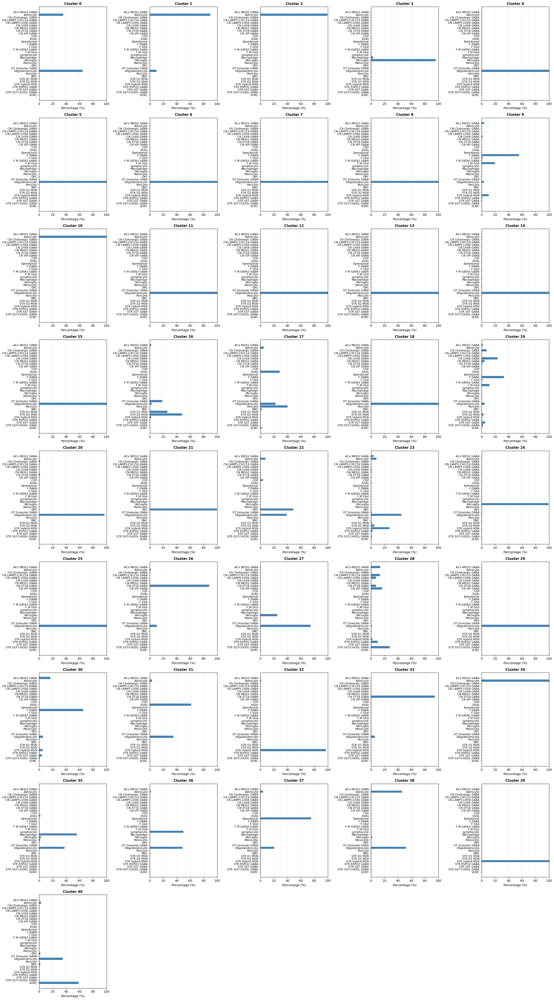

In [ ]:
# Calculate cell type percentages per cluster
cell_type_dist = (adata.obs.groupby(['leiden_4', 'Subclass_name'], observed=False)
                  .size()
                  .unstack(fill_value=0))

# Convert to percentages
cell_type_dist = cell_type_dist.div(cell_type_dist.sum(axis=1), axis=0) * 100

# CLusters wiht more thna 1 celltype
clusters_mixed = cell_type_dist[(cell_type_dist>=20).sum(axis=1)>=2].copy()
display(clusters_mixed)
putative_bad_clusters_by_cell_type = clusters_mixed.index.to_list()

# Get all clusters and cell types
all_clusters = cell_type_dist.index.tolist()
all_cell_types = cell_type_dist.columns.tolist()

# Create figure with 5 columns
n_clusters = len(all_clusters)
n_cols = 5
n_rows = int(np.ceil(n_clusters / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5*n_rows))
axes = axes.flatten()  # Flatten to make indexing easier

# Plot each cluster
for idx, cluster in enumerate(all_clusters):
    ax = axes[idx]
    
    # Get data for this cluster across all cell types
    values = cell_type_dist.loc[cluster, all_cell_types].values
    
    # Create horizontal bar plot
    y_positions = range(len(all_cell_types))
    ax.barh(y_positions, values, color='steelblue')
    ax.set_yticks(y_positions)
    ax.set_yticklabels(all_cell_types, fontsize=9)
    ax.set_xlabel('Percentage (%)', fontsize=10)
    ax.set_title(f'Cluster {cluster}', fontweight='bold', fontsize=11)
    ax.set_xlim(0, 100)
    ax.grid(axis='x', alpha=0.3)
    ax.axvline(0, color='black', linewidth=0.8)
    ax.invert_yaxis()  # Put first cell type at the top

# Hide empty subplots if number of clusters doesn't fill the grid
for idx in range(n_clusters, len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()


# Reprocess Clean Data

# Save

In [ ]:
# adata.write('/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/filtered_adata.h5ad')
# adata = sc.read_h5ad('/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/filtered_adata.h5ad')

# Plot

### MapMyCells Labels

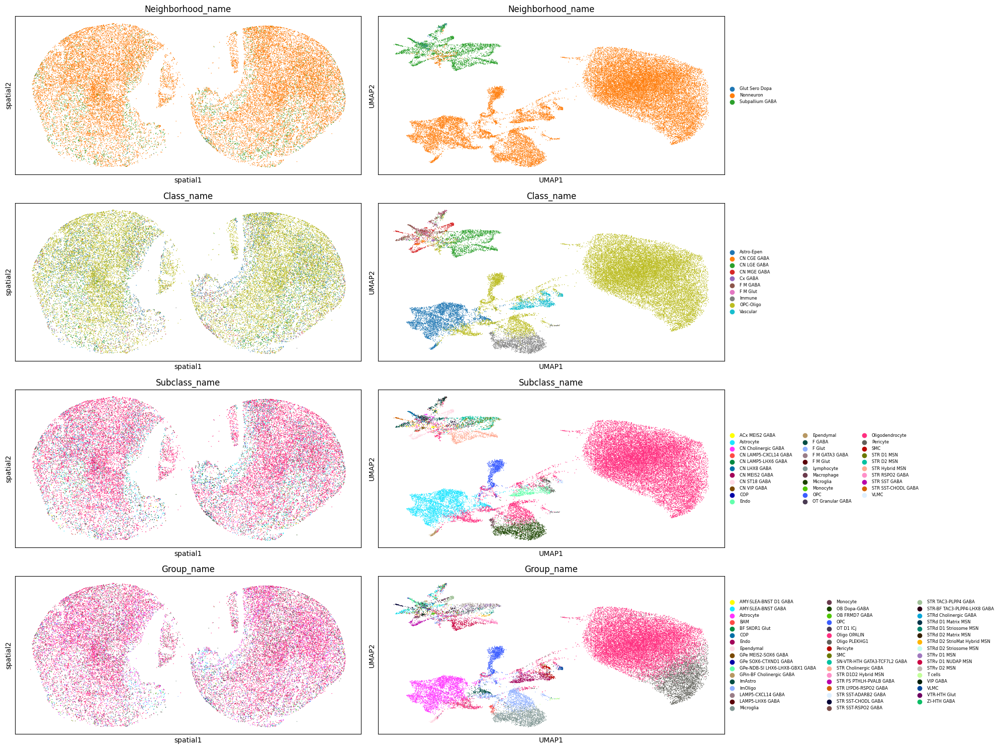

In [ ]:
fig, axes = plt.subplots(4, 2, figsize=(20, 15))

for i, res in enumerate(["Neighborhood_name", "Class_name", "Subclass_name", "Group_name"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_fontsize=6)# legend_loc="lower center")

plt.tight_layout()
plt.show()

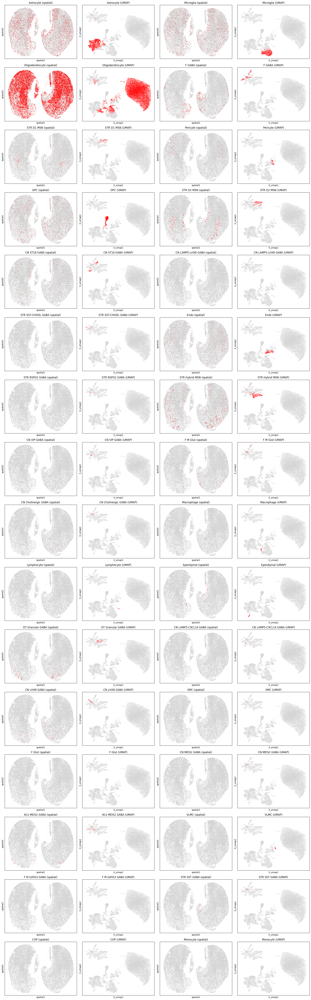

In [ ]:
subclasses = adata.obs["Subclass_name"].unique()
n_subclasses = len(subclasses)

# Calculate rows (ceiling division)
n_rows = int(np.ceil(n_subclasses / 2))
n_cols = 4

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4*n_rows))
axes = axes.flatten()  # Flatten to 1D for easy indexing

for i, s in enumerate(subclasses):
    # Create highlight column
    adata.obs["temp_highlight"] = adata.obs['Subclass_name'].apply(
        lambda x: s if x == s else 'Other'
    )
    
    # Spatial plot (left side: columns 0, 2, 4, ...)
    sc.pl.embedding(
        adata, 
        basis="spatial", 
        color="temp_highlight", 
        palette={'Other': 'lightgray', s: 'red'}, 
        ax=axes[i*2], 
        show=False, 
        legend_loc=None, 
        size=10,
        title=f"{s} (spatial)"
    )
    
    # UMAP plot (right side: columns 1, 3, 5, ...)
    sc.pl.embedding(
        adata, 
        basis="X_umap", 
        color="temp_highlight", 
        palette={'Other': 'lightgray', s: 'red'}, 
        ax=axes[i*2 + 1], 
        show=False, 
        legend_loc=None,
        title=f"{s} (UMAP)"
    )

# Hide unused subplots
for j in range(i*2 + 2, len(axes)):
    axes[j].axis('off')

# Clean up temp column
adata.obs.drop('temp_highlight', axis=1, inplace=True)

plt.tight_layout()
plt.show()

# MapMyCell cell types

In [ ]:
# # Add gene name
# t = adata.copy()
# gene_mapping = pd.read_csv("/home/gdallagl/myworkdir/XDP/data/BioMart/ensamble-name_biomart.txt", sep="\t").set_index("Gene stable ID")
# gene_mapping


# t.var = t.var.merge(gene_mapping, left_index=True, right_index=True, how="left").rename(columns={"Gene name":"gene_name"})

# t.var